<a href="https://colab.research.google.com/github/code-with-shannu/Pytorch/blob/main/Auto_annotate_YOLO_format_bounding_boxes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
home = os.getcwd()
print(home)

/content


In [ ]:
!nvidia-smi

Mon Jul 15 17:56:00 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
pip install autodistill

In [ ]:
!mkdir {home}/images

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%mv /content/drive/MyDrive/trafficlights/* /content/images

In [ ]:
pip install ultralytics

In [ ]:
!pip install -q \
autodistill \
autodistill-grounding-dino\
autodistill-yolov8 \
roboflow \
supervision==0.9.0

## 🏷️ Autolabel dataset

### Define ontology

**Ontology** - an Ontology defines how your Base Model is prompted, what your Dataset will describe, and what your Target Model will predict. A simple Ontology is the CaptionOntology which prompts a Base Model with text captions and maps them to class names. Other Ontologies may, for instance, use a CLIP vector or example images instead of a text caption.

In [ ]:
from autodistill.detection import CaptionOntology
ontology=CaptionOntology({
    "traffic light": "traffic lights",
    "traffic signs": "traffic sign",
    "car":"car",
    "person":"person",
    "bicycle":"bicycle",
    "bus":"bus",
    "motorcycle":"motorcycle",

})
DATASET_DIR_PATH = f"{home}/dataset"
IMAGE_DIR_PATH = f"{home}/images/"
from autodistill_grounding_dino import GroundingDINO
base_model = GroundingDINO(ontology=ontology)
dataset = base_model.label(
    input_folder=IMAGE_DIR_PATH,
    extension=".jpg",
    output_folder=DATASET_DIR_PATH)

trying to load grounding dino directly


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)


final text_encoder_type: bert-base-uncased


Labeling /content/images/trafficlight_google_0035.jpg:   0%|          | 0/283 [00:00<?, ?it/s]The `device` argument is deprecated and will be removed in v5 of Transformers.
torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
None of the inputs have requires_grad=True. Gradients will be None
The `device` argument is deprecated and will be removed in v5 of Transformers.
torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the dif

Labeled dataset created - ready for distillation.


In [ ]:
ANNOTATIONS_DIRECTORY_PATH = f"{home}/dataset/train/labels"
IMAGES_DIRECTORY_PATH = f"{home}/dataset/train/images"
DATA_YAML_PATH = f"{home}/dataset/data.yaml"
import supervision as sv
dataset = sv.DetectionDataset.from_yolo(
    images_directory_path=IMAGES_DIRECTORY_PATH,
    annotations_directory_path=ANNOTATIONS_DIRECTORY_PATH,
    data_yaml_path=DATA_YAML_PATH)
len(dataset)

226

In [ ]:
SAMPLE_SIZE = 282
import supervision as sv

image_names = list(dataset.images.keys())[:SAMPLE_SIZE]

mask_annotator = sv.MaskAnnotator()
box_annotator = sv.BoxAnnotator()

images = []
for image_name in image_names:
    image = dataset.images[image_name]
    annotations = dataset.annotations[image_name]
    labels = [
        dataset.classes[class_id]
        for class_id
        in annotations.class_id]
    annotates_image = mask_annotator.annotate(
        scene=image.copy(),
        detections=annotations)
    annotates_image = box_annotator.annotate(
        scene=annotates_image,
        detections=annotations,
        labels=labels)
    images.append(annotates_image)

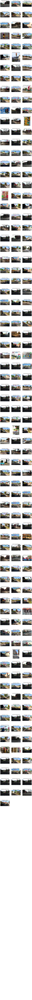

In [ ]:
SAMPLE_GRID_SIZE = (94, 3)
SAMPLE_PLOT_SIZE = (12,376)
sv.plot_images_grid(
    images=images,
    titles=image_names,
    grid_size=SAMPLE_GRID_SIZE,
    size=SAMPLE_PLOT_SIZE)

In [ ]:
from google.colab import files
import shutil

shutil.make_archive("dataset", 'zip', "dataset")
files.download("dataset.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>